# Modeling

In [1]:
import time
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import xgboost as xgb
from datetime import datetime
from lightgbm import LGBMClassifier
#from sklearn.datasets import make_classification
from sklearn.inspection import permutation_importance
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.metrics import (
    f1_score, roc_auc_score, confusion_matrix,
    precision_score, recall_score, roc_curve, auc, precision_recall_curve
)
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.utils.class_weight import compute_class_weight

warnings.filterwarnings("ignore")
np.random.seed(42)


In [2]:
start = time.time()

df = pd.read_csv("./data/accidents_preprocessed.csv")

end = time.time()

#Subtract Start Time from The End Time
total_time = end - start
print(f"Loaded dataset in {round(total_time, 2)}s")

Loaded dataset in 2.39s


In [3]:
cat_columns = ["col", "prof", "plan", "situ", "obs", "choc", "manv",
               "lum", "agg", "catr", "circ", "catv", "catu", "sexe"]

for col in cat_columns:
    df[col] = df[col].astype("category")

mapping = "binary"
if mapping == "binary":
    binary_mapping = {1: 0,
                      2: 0,
                      3: 1,
                      4: 1}

    df["grav"] = df["grav"].map(binary_mapping)
    
    grav_order = [1, 2, 3, 4]
    df["grav"] = pd.Categorical(df["grav"])

mapping = "binary"
if mapping == "ordinal":
    grav_order = [1, 2, 3, 4]
    df["grav"] = pd.Categorical(df["grav"], categories=grav_order, ordered=True)
if mapping == "binary":
    df["grav"] = pd.Categorical(df["grav"])

In [4]:
df.nbv.min()

0.0

In [5]:
df.grav.value_counts(normalize=True)

0    0.608549
1    0.391451
Name: grav, dtype: float64

## Train test split

Starting grid search for Random Forest...
Fitting grid search...
Fitting took 407.35s
Selecting best model...
Best model for Random Forest is:
{'clf__class_weight': {0: 1, 1: 3}, 'clf__max_depth': 10, 'clf__min_samples_leaf': 4, 'clf__min_samples_split': 10, 'clf__n_estimators': 300}
Predicting...
Evaluating...
Random Forest - Validation set:
F1-score: 0.6513, Precision: 0.5006, Recall: 0.9318, ROC-AUC: 0.6778
___


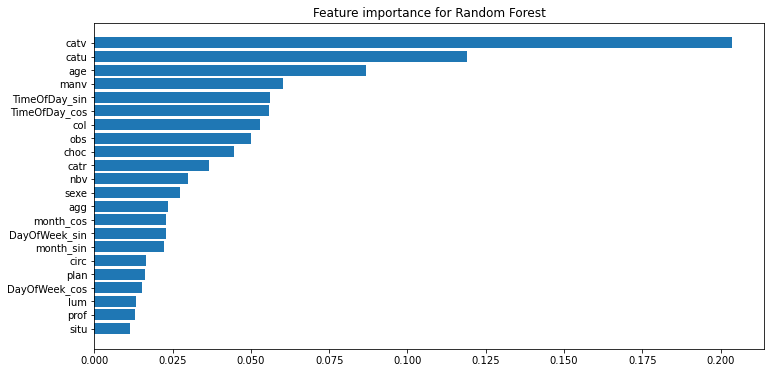

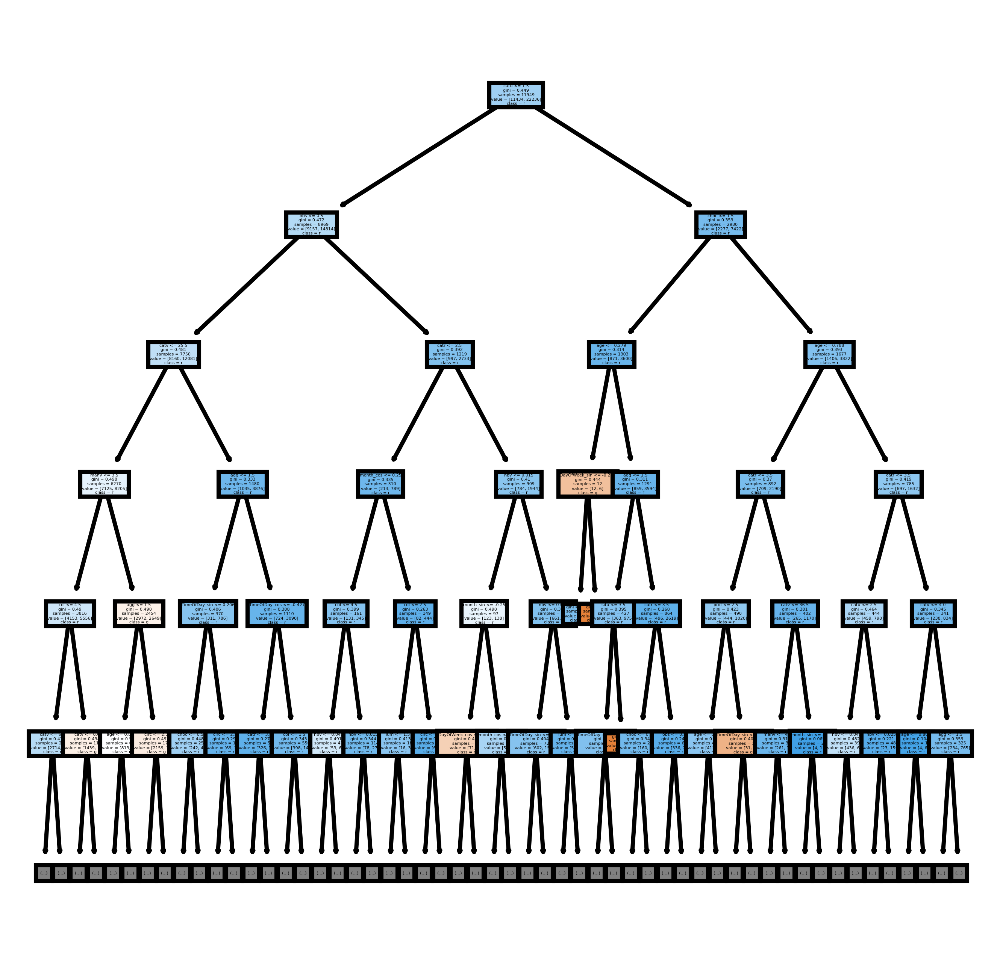

Starting grid search for XGBoost...
Fitting grid search...
Fitting took 15.25s
Selecting best model...
Best model for XGBoost is:
{'clf__learning_rate': 0.3, 'clf__max_depth': 6, 'clf__n_estimators': 100}
Predicting...
Evaluating...
XGBoost - Validation set:
F1-score: 0.8236, Precision: 0.8781, Recall: 0.7754, ROC-AUC: 0.8543
___


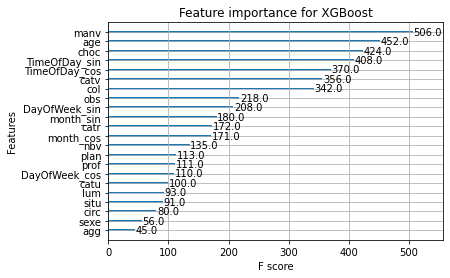

Starting grid search for LGBM Classifier...
Fitting grid search...
[LightGBM] [Info] Number of positive: 5863, number of negative: 9214
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.029932 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 819
[LightGBM] [Info] Number of data points in the train set: 15077, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.388870 -> initscore=-0.452063
[LightGBM] [Info] Start training from score -0.452063
[LightGBM] [Info] Number of positive: 5863, number of negative: 9214
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.036474 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 817
[LightGBM] [Info] Number of data points in t

In [ ]:
subset_size = 0.01  # 10% of the original data

# Randomly sample the subset from the original dataset
subset_df = df.sample(frac=subset_size, random_state=42)

# Assuming df is your DataFrame and "grav" is the target variable
X = subset_df.drop("grav", axis=1)
y = subset_df["grav"]

# Split the dataset into training, validation, and testing sets
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=0.25, random_state=42)

# Create the pipelines for each model
models = [
    ("Random Forest", Pipeline([("clf", RandomForestClassifier())])),
    ("XGBoost", Pipeline([("clf", xgb.XGBClassifier(enable_categorical=True, tree_method="hist"))])),
    ("LGBM Classifier", Pipeline([("clf", LGBMClassifier())])),
    ("Logistic Regression", Pipeline([("clf", LogisticRegression())])),
    ("Support Vector Machine", Pipeline([("clf", SVC())])),
    ("Neural Network", Pipeline([("clf", MLPClassifier())]))
]


# Define hyperparameter search space for each model
param_grids = {
    "Random Forest": {
        "clf__class_weight": [{0: 1, 1: 1}, {0: 1, 1: 2}, {0: 1, 1: 3}],
        "clf__n_estimators": [100, 200, 300],
        "clf__max_depth": [None, 10, 20],
        "clf__min_samples_split": [2, 5, 10],
        "clf__min_samples_leaf": [1, 2, 4]
    },
    "XGBoost": {
        "clf__n_estimators": [100, 200, 300],
        "clf__max_depth": [3, 6, 9],
        "clf__learning_rate": [0.01, 0.1, 0.3]
    },
    "LGBM Classifier": {
        "clf__num_leaves": [31, 63, 127],
        "clf__max_depth": [-1, 5, 10],
        "clf__learning_rate": [0.01, 0.05, 0.1],
        "clf__n_estimators": [50, 100, 200],
        "clf__min_child_samples": [20, 50, 100],
        "clf__colsample_bytree": [0.6, 0.8, 1.0],
        "clf__subsample": [0.6, 0.8, 1.0],
        "clf__reg_alpha": [0, 0.1, 0.5],
        "clf__reg_lambda": [0, 0.1, 0.5],
        "clf__scale_pos_weight": [1],
    },
    "Logistic Regression": {
        "clf__C": [0.1, 1, 10],
        "clf__solver": ["liblinear", "lbfgs"]
    },
    "Support Vector Machine": {
        "clf__C": [0.1, 1, 10],            # Regularization parameter
        "clf__kernel": ["linear", "rbf"],  # Kernel types ('linear' or 'rbf')
        "clf__gamma": [0.1, 1, "scale"],   # Kernel coefficient for 'rbf' (either a float or 'scale')
    },
    "Neural Network": {
        "clf__hidden_layer_sizes": [(50,), (100,), (50, 50), (100, 50)],
        "clf__activation": ["logistic", "relu"],
        "clf__alpha": [0.0001, 0.001, 0.01]
    }
}

# Train and evaluate each model using GridSearchCV
best_models = {}
validation_metrics = {}
test_metrics = {}

for name, model in models:
    start_time = time.time()
    print(f"Starting grid search for {name}...")
    grid_search = GridSearchCV(model, param_grids[name], cv=5, scoring="recall", n_jobs=-1)
    print("Fitting grid search...")
    grid_search.fit(X_train_val, y_train_val)
    train_time = time.time() - start_time
    print(f"Fitting took {round(train_time, 2)}s")
    
    print("Selecting best model...")
    best_model = grid_search.best_estimator_
    best_params = grid_search.best_params_
    print(f"Best model for {name} is:")
    print(best_params)
    print("Predicting...")
    y_pred = best_model.predict(X_val)
    print("Evaluating...")
    f1 = f1_score(y_val, y_pred)
    roc_auc = roc_auc_score(y_val, y_pred)
    precision = precision_score(y_val, y_pred)
    recall = recall_score(y_val, y_pred)
    validation_metrics[name] = {
        "F1-score": f1,
        "Precision": precision,
        "Recall": recall,
        "ROC-AUC": roc_auc
    }

    print(f"{name} - Validation set:")
    print(f"F1-score: {f1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, ROC-AUC: {roc_auc:.4f}")
    print("___")

    best_models[name] = {"model": best_model, "f1_score": f1, "precision": precision, "recall": recall, "roc_auc": roc_auc}

    if name in ["Random Forest", "LGBM Classifier"]:
        feature_importance = best_model.named_steps["clf"].feature_importances_
        sorted_idx = np.argsort(feature_importance)
        fig = plt.figure(figsize=(12, 6))
        plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align="center")
        plt.yticks(range(len(sorted_idx)), np.array(X_train_val.columns)[sorted_idx])
        plt.title(f"Feature importance for {name}")
        plt.show()

        rf = best_model.named_steps["clf"]
        tree = best_model.named_steps["clf"].estimators_[0]
        fn=X.columns
        cn=y.name
        fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(4,4), dpi=800)
        plot_tree(rf.estimators_[0],
                  feature_names=fn, 
                  class_names=cn,
                  filled=True,
                  max_depth=5
                 )
        fig.savefig("rf_individual_tree.png")
        plt.show()

    if name == "Logistic Regression":
        coefficients = best_model.named_steps["clf"].coef_[0]
        sorted_idx = np.argsort(coefficients)
        fig = plt.figure(figsize=(12, 6))
        plt.barh(range(len(sorted_idx)), coefficients[sorted_idx], align="center")
        plt.yticks(range(len(sorted_idx)), np.array(X_train_val.columns)[sorted_idx])
        plt.title(f"Coefficients for {name}")
        plt.show()

    if name == "Support Vector Machine":
        if best_params["clf__kernel"] == "linear":
            coefficients = best_model.named_steps["clf"].coef_[0]
            sorted_idx = np.argsort(coefficients)
            fig = plt.figure(figsize=(12, 6))
            plt.barh(range(len(sorted_idx)), coefficients[sorted_idx], align="center")
            plt.yticks(range(len(sorted_idx)), np.array(X_train_val.columns)[sorted_idx])
            plt.title(f"Coefficients for {name}")
            plt.show()
        else:
            perm_importance = permutation_importance(best_model, X_val, y_val, n_repeats=30, random_state=42)
            sorted_idx = perm_importance.importances_mean.argsort()
            fig, ax = plt.subplots(figsize=(12, 6))
            ax.boxplot(perm_importance.importances[sorted_idx].T, vert=False, labels=np.array(X_val.columns)[sorted_idx])
            ax.set_title(f"Permutation Feature Importance for {name}")
            plt.show()

    if name == "XGBoost":
        xgb.plot_importance(best_model.named_steps["clf"])
        plt.title(f"Feature importance for {name}")
        plt.show()
        
# Find the best model for each modeling technique based on the F1-score
best_model_by_technique = {}
for name, model_info in best_models.items():
    model = model_info["model"]
    if name not in best_model_by_technique or model_info["f1_score"] > best_model_by_technique[name]["f1_score"]:
        best_model_by_technique[name] = model_info    

# Evaluate the best models on the test set
for name, model_info in best_model_by_technique.items():
    model = model_info["model"]
    start_time = time.time()
    model.fit(X_train_val, y_train_val)
    train_time = time.time() - start_time
    print(f"Fitting took {round(train_time, 2)}s")
    print("Evaluating...")
    y_pred_test = model.predict(X_test)
    f1_test = f1_score(y_test, y_pred_test)
    roc_auc_test = roc_auc_score(y_test, y_pred_test)
    precision_test = precision_score(y_test, y_pred_test)
    recall_test = recall_score(y_test, y_pred_test)
    
    test_metrics[name] = {
        "F1-score": f1_test,
        "Precision": precision_test,
        "Recall": recall_test,
        "ROC-AUC": roc_auc_test
    }
    
    print(f"{name} - Testing set:")
    print(f"F1-score: {f1:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}, ROC-AUC: {roc_auc:.4f}")
    print("___")

In [ ]:
best_model

In [ ]:
now = datetime.now()
current_time = now.strftime("%H:%M:%S")
print(f"Last run at {current_time}")